# Location Analytics for finding Best Location for a New Indian Restaurant in Toronto

In this notebook, I will work towards finding the best neighborhood in Toronto for a new Indian/Pakistani restaurant. In the following, I will first work describe the data we are going to use. followed by some data wrangling and exploratory analysis and visualizations. Towards the end of the notebook, I will perform cluster analysis to cluster similar neighborhood, in terms of suitability for opening a new Indian/Pakistani restaurant, together and propose the best neigborhood based on the analysis

#### Before we start, let's first import the required libraries

In [69]:
# need fiona with gdal < 2 (it's not yet compatible, although conda tries to install gdal 2)
#!conda install fiona "libgdal<2.0"  --yes
# basic dependencies -> this possibly needs to reinstall numpy to ensure it's the correct version that pandas needs (fiona downgrades numpy, leaving an already install pandas possibly broken)
#!conda install pandas matplotlib  --yes
# install shapely from ioos + its dependecies
#!conda install -c ioos shapely pyproj  --yes
# install geopandas and descarted from ioos without updating its dependencies -> tries to update fiona/pyproj -> see problems above
#!conda install -c ioos geopandas descartes --no-deps --yes
#!conda install -c conda-forge shapely --yes
#!conda install -c conda-forge folium=0.5.0 --yes

#!conda install pyshp --yes
#!conda install geopandas --yes

#import geopandas as gpd

import pandas as pd
import numpy as np
import csv

import shapefile
import json # library to handle JSON files
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
import folium # map rendering library

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler


import shapely
from shapely.geometry import shape, Point, MultiPoint, Polygon, MultiPolygon
from shapely.geometry.polygon import Polygon

## Data Collection and Preparation

In this project, we are going to use the following data sets:
1. List of neigbourhood - From Toronto City's Open Data Catalogue - The data is availble in **shapefile**
2. Neighbourhood profiles - From Toronto City's Open Data Catalogue - The data is availble in **CSV** and contains various social and economic indicators of each neighbourhood
3. Crime rates in neighbourhoods - Toronto Police Open Data - The data is available in **shapefile**
4. Access to Public Transport and Transport Safety by neighbourhood - From Toronto City's Open Data Catalogue - The data is available in **CSV** format
5. Location of Parking slots - From Toronto City's Open Data Catalogue - The data set is availble in **JSON** format
6. List of Indian/Pakistani restaurants in each neighbourhood - Foursquare - The data will be read in to a data frame using **Foursquare API**

### List of Toronto's neighbourhoods

The shapefile containing the list of neighbourhoods is downloaded from http://opendata.toronto.ca/gcc/neighbourhood_planning_areas_utm6.zip

Let's define a function that reads the shapefile in to a data frame

In [4]:
def read_shapefile(shp_path):
    """
    Read a shapefile into a Pandas dataframe with a 'coords' column holding
    the geometry information. This uses the pyshp package
    """
    import shapefile
    #read file, parse out the records and shapes
    sf = shapefile.Reader(shp_path)
    fields = [x[0] for x in sf.fields][1:]
    records = sf.records()
    shps = [s.points for s in sf.shapes()]

    #write into a dataframe
    df = pd.DataFrame(columns=fields, data=records)
    df = df.assign(coords=shps)
    return df

Execute the function to read the NEIGHBOURHOODS_UTM6.shp

In [105]:
df_neighbourhood=read_shapefile('NeighbourhoodsProfile/NEIGHBORHOODS_WGS84.shp')

In [106]:
df_neighbourhood.head()

,AREA_S_CD,AREA_NAME,coords
0,097,Yonge-St.Clair (97),"[(-79.391194827, 43.681081124), (-79.391405432..."
1,027,York University Heights (27),"[(-79.505287916, 43.759873494), (-79.504882558..."
2,038,Lansing-Westgate (38),"[(-79.439984311, 43.761557655), (-79.440036657..."
3,031,Yorkdale-Glen Park (31),"[(-79.439687326, 43.705609818), (-79.440110286..."
4,016,Stonegate-Queensway (16),"[(-79.492621197, 43.64743635), (-79.492769811,..."


In [107]:
df_neighbourhood.shape

(140, 3)

### The neigbourhood's profiles

The CSV containing the list of neighbourhoods profiles is downloaded from https://www.toronto.ca/ext/open_data/catalog/data_set_files/2016_neighbourhood_profiles.csv

Let's read the file in to a data frame. The original file contains a huge number of indicators so for simplicity the file was already cleaned to reflect the indicators of interest only. 

In [108]:
df_profiles=pd.read_csv('neighbourhood_profiles.csv')

In [109]:
df_profiles.head()

,Characteristic,City of Toronto,Agincourt North,Agincourt South-Malvern West,Alderwood,Annex,Banbury-Don Mills,Bathurst Manor,Bay Street Corridor,Bayview Village,...,Willowdale West,Willowridge-Martingrove-Richview,Woburn,Woodbine Corridor,Woodbine-Lumsden,Wychwood,Yonge-Eglinton,Yonge-St.Clair,York University Heights,Yorkdale-Glen Park
0,Neighbourhood Number,NaN,129.00,128.00,20.00,95.00,42.00,34.00,76.00,52.00,...,37.00,7.00,137.0,64.00,60.00,94.00,100.00,97.00,27.0,31.00
1,"Population, 2016",2731571.00,29113.00,23757.00,12054.00,30526.00,27695.00,15873.00,25797.00,21396.00,...,16936.00,22156.00,53485.0,12541.00,7865.00,14349.00,11817.00,12528.00,27593.0,14804.00
2,Population Change 2011-2016,0.05,-0.04,0.08,0.01,0.05,0.03,0.03,0.33,0.21,...,0.13,0.04,0.0,0.07,0.01,0.03,0.12,0.08,0.0,0.01
3,Population density per square kilometre,4334.00,3929.00,3034.00,2435.00,10863.00,2775.00,3377.00,14097.00,4195.00,...,5820.00,4007.00,4345.0,7838.00,6722.00,8541.00,7162.00,10708.00,2086.0,2451.00
4,0-14 years,398135.00,3840.00,3075.00,1760.00,2360.00,3605.00,2325.00,1695.00,2415.00,...,1785.00,3555.00,9625.0,2325.00,1165.00,1860.00,1800.00,1210.00,4045.0,1960.00


Change the index to Characteristic

In [110]:
df_profiles.set_index('Characteristic',inplace=True)

We do not need the indicators for the City of Toronto, so let's remove that

In [111]:
df_profiles.drop(['City of Toronto'], axis=1, inplace=True)

In [112]:
df_profiles.dtypes

Agincourt North                      float64
Agincourt South-Malvern West         float64
Alderwood                            float64
Annex                                float64
Banbury-Don Mills                    float64
Bathurst Manor                       float64
Bay Street Corridor                  float64
Bayview Village                      float64
Bayview Woods-Steeles                float64
Bedford Park-Nortown                 float64
Beechborough-Greenbrook              float64
Bendale                              float64
Birchcliffe-Cliffside                float64
Black Creek                          float64
Blake-Jones                          float64
Briar Hill-Belgravia                 float64
Bridle Path-Sunnybrook-York Mills    float64
Broadview North                      float64
Brookhaven-Amesbury                  float64
Cabbagetown-South St. James Town     float64
Caledonia-Fairbank                   float64
Casa Loma                            float64
Centennial

In [113]:
df_profiles=df_profiles.T
df_profiles.head()

Characteristic,Neighbourhood Number,"Population, 2016",Population Change 2011-2016,Population density per square kilometre,0-14 years,15-24 years,25-54 years,55-64 years,2006 to 2010,2011 to 2016,Ethnic - East Indian,Ethnic - Goan,Ethnic - Gujarati,Ethnic - Kashmiri,Ethnic - Pakistani,Ethnic - Punjabi,After-tax income - Average
Agincourt North,129.0,29113.0,-0.04,3929.0,3840.0,3705.0,11305.0,4230.0,2750.0,2165.0,2090.0,10.0,20.0,0.0,230.0,55.0,26955.0
Agincourt South-Malvern West,128.0,23757.0,0.08,3034.0,3075.0,3360.0,9965.0,3265.0,2140.0,1735.0,2180.0,30.0,10.0,10.0,410.0,20.0,27928.0
Alderwood,20.0,12054.0,0.01,2435.0,1760.0,1235.0,5220.0,1825.0,255.0,200.0,495.0,20.0,0.0,0.0,50.0,20.0,39159.0
Annex,95.0,30526.0,0.05,10863.0,2360.0,3750.0,15040.0,3480.0,870.0,975.0,965.0,10.0,0.0,25.0,125.0,15.0,80138.0
Banbury-Don Mills,42.0,27695.0,0.03,2775.0,3605.0,2730.0,10810.0,3555.0,1665.0,1500.0,2365.0,30.0,40.0,0.0,325.0,10.0,51874.0


Now, let's convert all columns type except Population change to int

In [114]:
col_list=list(df_profiles)
col_list.remove('Population Change 2011-2016')
df_profiles[col_list]=df_profiles[col_list].astype('int64')

Now, sum the age columns to get the total poulation of our interest

In [115]:
df_profiles['Target Population by age'] = df_profiles['0-14 years']+df_profiles['15-24 years']+df_profiles['25-54 years']+df_profiles['55-64 years']

In [116]:
df_profiles.drop(['0-14 years','15-24 years','25-54 years','55-64 years'], axis=1, inplace=True)

Similarly, traget population by ethnic origin

In [117]:
df_profiles['Target Population by Ethnicity'] = df_profiles['Ethnic - East Indian']+df_profiles['Ethnic - Goan']+df_profiles['Ethnic - Gujarati']+df_profiles['Ethnic - Kashmiri']+df_profiles['Ethnic - Pakistani']+df_profiles['Ethnic - Punjabi']

In [118]:
df_profiles.drop(['Ethnic - East Indian','Ethnic - Goan','Ethnic - Gujarati','Ethnic - Kashmiri','Ethnic - Pakistani','Ethnic - Punjabi'], axis=1, inplace=True)

In [119]:
df_profiles.rename(columns={'After-tax income - Average ' : 'Average Income'}, inplace=True)

Now, calculate the change in number of immigrants

In [120]:
df_profiles['Immigrants Population Change'] = (df_profiles['2011 to 2016']-df_profiles['2006 to 2010'])/df_profiles['2006 to 2010']
df_profiles.drop(['2011 to 2016','2006 to 2010'], axis=1, inplace=True)

### The crime rates by neigbourhood

The data set is available at http://data.torontopolice.on.ca/datasets/neighbourhood-crime-rates-boundary-file-

In [121]:
df_crime=read_shapefile('NeighbourhoodsCrime/Neighbourhood_Crime_Rates_Boundary_File_.shp')
df_crime.head(5)

,OBJECTID,AREA_S_CD,Neighbourh,Assault_20,AutoTheft_,BreakandEn,Robbery_20,TheftOver_,Homicide_2,Total_2014,...,Assault_Ra,AutoThef_6,Breakand_6,Robbery_Ra,TheftOve_6,Homicide_R,Total_Rate,Shape__Are,Shape__Len,coords
0,1,097,Yonge-St.Clair (97),16,3,32,2,2,0,55,...,721.229225,94.073377,533.082471,62.715585,94.073377,0.000000,1505.174036,1.161309e+06,5873.097806,"[(629677.947887097, 4837493.94967207), (629661..."
1,2,027,York University Heights (27),269,118,98,60,28,1,574,...,859.536503,282.885431,288.325536,195.843760,97.921880,2.720052,1729.953215,1.324698e+07,18504.936210,"[(620323.539535925, 4846072.79718193), (620355..."
2,3,038,Lansing-Westgate (38),38,16,41,10,5,0,110,...,517.477055,205.038079,371.021285,78.109744,48.818590,0.000000,1220.464753,5.346378e+06,11112.316458,"[(625576.979301742, 4846356.79409302), (625572..."
3,4,031,Yorkdale-Glen Park (31),106,63,51,23,24,1,268,...,795.261339,285.197170,318.104536,142.598585,120.660341,5.484561,1661.821971,6.038420e+06,10079.442748,"[(625717.895589513, 4840143.49174234), (625683..."
4,5,016,Stonegate-Queensway (16),93,35,68,14,8,0,218,...,378.259107,130.589454,238.663484,72.049354,31.521592,0.000000,851.082992,7.946086e+06,11853.054621,"[(621570.259036723, 4833603.71064699), (621558..."


Here, we are just interested in overall crime rate by neighbourhood. So let's filter out the rest of the columns

In [122]:
df_crime = df_crime.filter(items=['AREA_S_CD','Neighbourh','Total_Rate'])

In [123]:
df_crime.shape

(140, 3)

### Access to public transport and transport safety by neighbourhood

The data set is avaialble at http://opendata.toronto.ca/social.development/wellbeing/WB-Transportation.xlsx

In [124]:
df_transport=pd.read_csv('WB-Transportation.csv')
df_transport.set_index('Neighbourhood',inplace=True)

In [125]:
df_transport.drop(['Road Kilometres','Road Volume'], axis=1, inplace=True)

### Parking Slots by neigbourhood

The data set is available at https://www.toronto.ca/ext/open_data/catalog/data_set_files/greenPParking2015.json

Let's load the data from JSON file

In [126]:
with open('greenPParking.json') as json_data:
    park_data = json.load(json_data)

In [127]:
parking_data=park_data['carparks']
parking_data[0]

{'id': '1',
 'address': '20 Charles Street',
 'lat': '43.668997',
 'lng': '-79.385093',
 'rate': '$2.00 / Half Hour',
 'carpark_type': 'garage',
 'carpark_type_str': 'Garage',
 'is_ttc': False,
 'rate_half_hour': '2.00',
 'capacity': '430',
 'max_height': '2.00',
 'payment_methods': ['Bills',
  'Coins',
  'Charge (Visa / Mastercard / American Express Only)'],
 'payment_options': ['Auto Express Pay Stations',
  'Credit Card at Entry & Exit',
  'Customer Assistance Booth'],
 'rate_details': {'periods': [{'title': 'Monday - Sunday & Holidays',
    'rates': [{'when': 'Day Maximum (7am - 6pm)', 'rate': '$12.00'},
     {'when': 'Night Maximum (6pm - 7am)', 'rate': '$6.00'}],
    'notes': ['Unreserved Monthly permit price - $220',
     'Permits currently available',
     'Inquires at monthlypermits@greenp.com or',
     '416-393-7348']}],
  'addenda': []},
 'enable_streetview': 'yes',
 'streetview_lat': '43.668822',
 'streetview_long': '-79.385262',
 'streetview_yaw': '321.21',
 'streetview_pi

We are itnerested only in the parking IDs, lat, lng and acapcity attributes. So, first let's create a data frame with these columns.

In [128]:
column_names = ['Parking ID', 'Latitude', 'Longitude', 'Capacity'] 
df_parkings = pd.DataFrame(columns=column_names)

Now, let's read in all the parkings in the data frame

In [129]:
for data in parking_data:
    ID = data['id'] 
 
    Latitude = data['lat'] 
    Longitude = data['lng'] 
    Capacity = data['capacity'] 
    
    df_parkings = df_parkings.append({'Parking ID': ID,
                                          'Capacity': Capacity,
                                          'Latitude': Latitude,
                                          'Longitude': Longitude}, ignore_index=True)

In [130]:
df_parkings.shape

(239, 4)

Now, the next task is to assign neigbourhood to each parking and calculate the total number of parking slots by neighbourhood. 
First of all we will need to change the data types of LAtitude and Longitude to float as they were read as string.

In [131]:
df_parkings[['Latitude','Longitude']]=df_parkings[['Latitude','Longitude']].astype('float64')

Now, loop over each parking slot to find the neigbourhood it belongs to and assign the neighbourhood id and name in the dataframe

In [132]:
counter=0
for p_index, p_row in df_parkings.iterrows():
    point=Point(p_row['Longitude'],p_row['Latitude'])
    for n_index, n_row in df_neighbourhood.iterrows():
        polygon = Polygon(n_row['coords'])
        if(polygon.contains(point)):
            df_parkings.loc[p_index, 'Neigbourhood Id'] = n_row['AREA_S_CD']
            df_parkings.loc[p_index, 'Neigbourhood'] = n_row['AREA_NAME']
            counter=counter+1
            break
print('{} rows updated'.format(counter))
df_parkings.head()

239 rows updated


,Parking ID,Latitude,Longitude,Capacity,Neigbourhood Id,Neigbourhood
0,1,43.668997,-79.385093,430,075,Church-Yonge Corridor (75)
1,3,43.667577,-79.384707,33,075,Church-Yonge Corridor (75)
2,5,43.664837,-79.383591,135,075,Church-Yonge Corridor (75)
3,11,43.687092,-79.392850,557,098,Rosedale-Moore Park (98)
4,12,43.689202,-79.393269,188,098,Rosedale-Moore Park (98)


### Find the number of Indian/Pakistani restaurants in each neighbourhood

To find the number of restaurants, we will mak a regular call using Foursquare API against the name of each neighbourhood. Therefore, first of all let's assign the Foursquare API credentials

In [133]:
CLIENT_ID = 'QLRD3HG41XTO2D30IZODMRHOXSVTLYONJO01ADKWZ4XNUH52' # your Foursquare ID
CLIENT_SECRET = 'XOLYRG5CI5MKBLJGRHEHN53SYDZTA1P42KV5T2DOUW0UQLK3' # your Foursquare Secret
VERSION = '20180915' # Foursquare API version

LIMIT = 100
radius = 5000 # define radius

search_query = 'Indian Pakistani Restaurant'

In [134]:
column_names = ['Neighbourhood ID', 'Neighbourhood', 'Restaurants Count'] 
df_restaurant = pd.DataFrame(columns=column_names)
df_restaurant

,Neighbourhood ID,Neighbourhood,Restaurants Count


Let's now prepare our query for the Foursquare API. We will need to find the centroid of each neighbourhood that we will use as input location. 

In [135]:
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    latitude, 
    longitude, 
    VERSION, 
    search_query, 
    radius, 
    LIMIT)
    
    results = requests.get(url).json()
    no_rest=len(results['response']['venues']) # number of restaurants returned 
    df_restaurant = df_restaurant.append({'Neighbourhood ID': n_row['AREA_S_CD'],
                                          'Neighbourhood': n_row['AREA_NAME'],
                                          'Restaurants Count': no_rest}, ignore_index=True)
    
print('Done....')

Done....


In [104]:
df_restaurant.head()

,Neighbourhood ID,Neighbourhood,Restaurants Count
0,97,Yonge-St.Clair (97),7
1,27,York University Heights (27),1
2,38,Lansing-Westgate (38),1
3,31,Yorkdale-Glen Park (31),1
4,16,Stonegate-Queensway (16),0


### Merge all the data in a single dataframe

Let's remove the unnecessary columns from each dataframe and change the neighbourhood id to int64. This is the column we will use for merging.

In [37]:
df_neighbourhood[['AREA_S_CD']]=df_neighbourhood[['AREA_S_CD']].astype('int64')

In [38]:
df_profiles.head(1)

Characteristic,Neighbourhood Number,"Population, 2016",Population Change 2011-2016,Population density per square kilometre,Average Income,Target Population by age,Target Population by Ethnicity,Immigrants Population Change
Agincourt North,129,29113,-0.04,3929,26955,23080,2405,-0.212727


In [39]:
df_profiles=df_profiles.reset_index()
df_profiles[['Neighbourhood Number']]=df_profiles[['Neighbourhood Number']].astype('int64')
df_profiles.rename(columns={'index': 'Neighbourhood', 'Neighbourhood Number':'N_ID'}, inplace=True)

We will be using neighbourhood name from the df_profiles, so let us remove this column from all other dataframes

In [40]:
df_crime[['AREA_S_CD']]=df_crime[['AREA_S_CD']].astype('int64')
df_crime.drop(['Neighbourh'], axis=1, inplace=True)
df_crime.rename(columns={'AREA_S_CD':'N_ID','Total_Rate':'Crime Rate'}, inplace=True)

In [41]:
df_transport=df_transport.reset_index()
df_transport[['Neighbourhood Id']]=df_transport[['Neighbourhood Id']].astype('int64')
#df_transport=df_transport.reset_index()
df_transport.drop(['Neighbourhood'], axis=1, inplace=True)
df_transport.rename(columns={'Neighbourhood Id':'N_ID'}, inplace=True)

In [42]:
df_parkings=df_parkings[['Neigbourhood Id','Capacity']]
df_parkings[['Neigbourhood Id','Capacity']]=df_parkings[['Neigbourhood Id','Capacity']].astype('int64')
df_parkings.rename(columns={'Neigbourhood Id':'N_ID','Capacity':'Parking Capacity'}, inplace=True)
df_parkings=df_parkings.groupby(['N_ID']).sum().reset_index()
df_parkings.head(1)

,N_ID,Parking Capacity
0,3,23


In [43]:
df_parkings=df_parkings.groupby(['N_ID']).sum().reset_index()
df_parkings.shape

(79, 2)

In [44]:
df_restaurant=df_restaurant[['Neighbourhood ID','Restaurants Count']]
df_restaurant[['Neighbourhood ID','Restaurants Count']]=df_restaurant[['Neighbourhood ID','Restaurants Count']].astype('int64')
df_restaurant.rename(columns={'Neighbourhood ID':'N_ID'}, inplace=True)

In [45]:
df_restaurant.shape

(140, 2)

Now as the dataframes are ready, let's merge them together in a new dataframe

In [46]:
df_data=pd.merge(df_profiles, df_crime, on='N_ID',how='inner')

In [47]:
df_data.shape

(140, 10)

In [48]:
df_data=pd.merge(df_data, df_transport, on='N_ID',how='inner')
df_data.shape

(140, 14)

For df_parkings, we need to perform left join as it does not have values for every neighbourhood

In [49]:
df_data=pd.merge(df_data, df_parkings, on='N_ID',how='left')
df_data['Parking Capacity'].fillna(0, inplace=True)
df_data.shape

(140, 15)

In [50]:
df_data=pd.merge(df_data, df_restaurant, on='N_ID',how='inner')
df_data.shape

(140, 16)

Check, if there is any null value in the data set

In [51]:
df_data.isnull().any()

Neighbourhood                              False
N_ID                                       False
Population, 2016                           False
Population Change 2011-2016                False
Population density per square kilometre    False
Average Income                             False
Target Population by age                   False
Target Population by Ethnicity             False
Immigrants Population Change               False
Crime Rate                                 False
TTC Stops                                  False
TTC Overcrowded Routes                     False
Pedestrian/Other Collisions                False
Traffic Collisions                         False
Parking Capacity                           False
Restaurants Count                          False
dtype: bool

As our data set is ready, let's start our analysis

## Data Visualization and Analysis

In this section, we analyze the data to find the best location for a new Indian/Pakistani restaurant. Precisely, we perform the following analytics:
1. Visualizing the data variables in choropleth maps
2. Correlation analysis to find out the determinants for restaurants in a neighbourhood
3. Clustering to group similar nieghbourhoods togehter
4. Analyzing clusters to find out the the cluster of neighbourhoods that is the best for opening the restaurant.

### Spatial visualizaton of data

For the visualization through chorpleth maps, we will need JSON of the neighbourhood boundaries. So, let's convert our data frame *df_neighbourhood* in to JSON

In [52]:
def shapefile_toJson(shp_path,dest):
    import shapefile
    # read the shapefile
    reader = shapefile.Reader(shp_path)
    fields = reader.fields[1:]
    field_names = [field[0] for field in fields]
    buffer = []
    for sr in reader.shapeRecords():
        atr = dict(zip(field_names, sr.record))
        geom = sr.shape.__geo_interface__
        buffer.append(dict(type="Feature", geometry=geom, properties=atr)) 
   
    # write the GeoJSON file
    from json import dumps
    geojson = open(dest, "w")
    geojson.write(dumps({"type": "FeatureCollection","features": buffer}, indent=2) + "\n")
    geojson.close()

In [53]:
shapefile_toJson('NeighbourhoodsProfile/NEIGHBORHOODS_WGS84.shp','toronto_neighbourhoods.json')

The 'N_ID' in the JSON has length of 3 with leading zeros in case of N_ID less than 100. So, in the following zeros are added to the string

In [54]:
df_data['N_ID'] = df_data['N_ID'].apply(lambda x: str(x))
df_data['N_ID'] = df_data['N_ID'].apply(lambda x: x.zfill(3))

Now, start visualizing ...

#### Population distribution in the city of Toronto

The population data availble is of 2016, so let's create a choropleth map with displaying the population distribution in the neighbourhoods of the GTA

In [55]:
toronto_geo = r'toronto_neighbourhoods.json'

In [56]:
# let Folium determine the scale.
population_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
population_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Population, 2016'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Population in 2016',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(population_map)

population_map.save('screenshots/population.html')
population_map

#### Population change 2011 - 2016 by nieghbourhood

In [57]:
# let Folium determine the scale.
pop_change_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
pop_change_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Population Change 2011-2016'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='YlOrBr', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Population Change 2011-2016',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(pop_change_map)

pop_change_map.save('screenshots/pop_change.html')
pop_change_map

#### Population density per square kilometer

In [58]:
# let Folium determine the scale.
pop_density_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
pop_density_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Population density per square kilometre'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='Oranges', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Population density per square kilometre',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(pop_density_map)

pop_density_map.save('screenshots/pop_density.html')
pop_density_map

#### Average income by neighbourhood

In [59]:
# let Folium determine the scale.
income_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
income_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Average Income'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='Greens', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average Income',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(income_map)

income_map

#### Presence of potential customers according to age

In [60]:
# let Folium determine the scale.
customer_age_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
customer_age_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Target Population by age'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='PuRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Age-based presence of cutomers in neighbourhoods',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(customer_age_map)

customer_age_map.save('screenshots/customer_age.html')
customer_age_map

#### Presence of potential customers according to ethnicity

In [61]:
# let Folium determine the scale.
customer_ethnic_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
customer_ethnic_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Target Population by Ethnicity'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='PuBu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Presence of Indian/Pakistani cutomers in neighbourhoods',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(customer_ethnic_map)

customer_ethnic_map.save('screenshots/cutomer_ethnic.html')
customer_ethnic_map

#### Rate of change in immigrants population over last five years in each neighbourhood

In [62]:
# let Folium determine the scale.
immi_change_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
immi_change_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Immigrants Population Change'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='PuBuGn', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Change in rate of immigrants in GTA over last five years',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(immi_change_map)

immi_change_map.save('screenshots/immichange.html')
immi_change_map

#### Crimes rate by neighbourhood

In [63]:
# let Folium determine the scale.
crime_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
crime_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Crime Rate'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='Reds', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Crime Rate in GTA',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(crime_map)

crime_map.save('screenshots/crimes.html')
crime_map

#### Access to Public Transport (TTC Stops) in each neighbourhood

In [64]:
# let Folium determine the scale.
ttc_stops_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
ttc_stops_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'TTC Stops'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='BuGn', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='TTC stops by neighbourhood',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(ttc_stops_map)

ttc_stops_map.save('screenshots/ttc_stops.html')
ttc_stops_map

#### Crowded TTC routes by neighbourhood

In [ ]:
# let Folium determine the scale.
ttc_crowd_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
ttc_crowd_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'TTC Overcrowded Routes'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='YlGn', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='TTC Overcrowded Routes by neighbourhood',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(ttc_crowd_map)

ttc_crowd_map.save('screenshots/ttc_crowd.html')
ttc_crowd_map

#### Pedestrian collisions by nieghbourhood

In [ ]:
# let Folium determine the scale.
ped_coll_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
ped_coll_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Pedestrian/Other Collisions'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='OrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Pedestrian collisions by neighbourhood',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(ped_coll_map)

ped_coll_map.save('screenshots/pedestrian_collision.html')
ped_coll_map

#### Traffic Collisions by nieghbourhood

In [ ]:
# let Folium determine the scale.
traffic_coll_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
traffic_coll_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Traffic Collisions'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='Reds', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Traffic collisions by neighbourhood',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(traffic_coll_map)

traffic_coll_map.save('screenshots/trafficCollision.html')
traffic_coll_map

#### Parking spaces by neighbourhood

In [ ]:
# let Folium determine the scale.
parking_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
parking_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Parking Capacity'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='Greens', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Parking Capacity by neighbourhood',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(parking_map)

parking_map.save('screenshots/parking.html')
parking_map

#### Presence of competitiors (other Indian Pakistani restaurants) by neighbourhood

In [ ]:
# let Folium determine the scale.
competitors_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
competitors_map.choropleth(
    geo_data=toronto_geo,
    data=df_data,
    columns=['N_ID', 'Restaurants Count'],
    key_on='feature.properties.AREA_S_CD',
    fill_color='Blues', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Presence of competitors by neigbourhood',
    reset=True
)

#Let's add markers, to help know the name of the neighbourhood
for n_index, n_row in df_neighbourhood.iterrows():
    polygon = Polygon(n_row['coords'])
    x,y = polygon.centroid.xy
    longitude=x[0]
    latitude=y[0]
    popup = folium.Popup(n_row['AREA_NAME'], parse_html=True)
    folium.CircleMarker([latitude,longitude], popup=popup,
                        radius=3, color='white').add_to(competitors_map)

competitors_map.save('screenshots/competitors.html')
    
competitors_map

### Correlation analysis

Before we go further, it would be interesting to visualizae the correlation among different variables. So, let's create a new data frame without neighbourhood ID and names

In [75]:
df_variables=df_data.drop(['Neighbourhood','N_ID'], axis=1, inplace=False)

Now, let's visualize a correlation matrix plot

In [76]:
names=list(df_variables.columns.values)

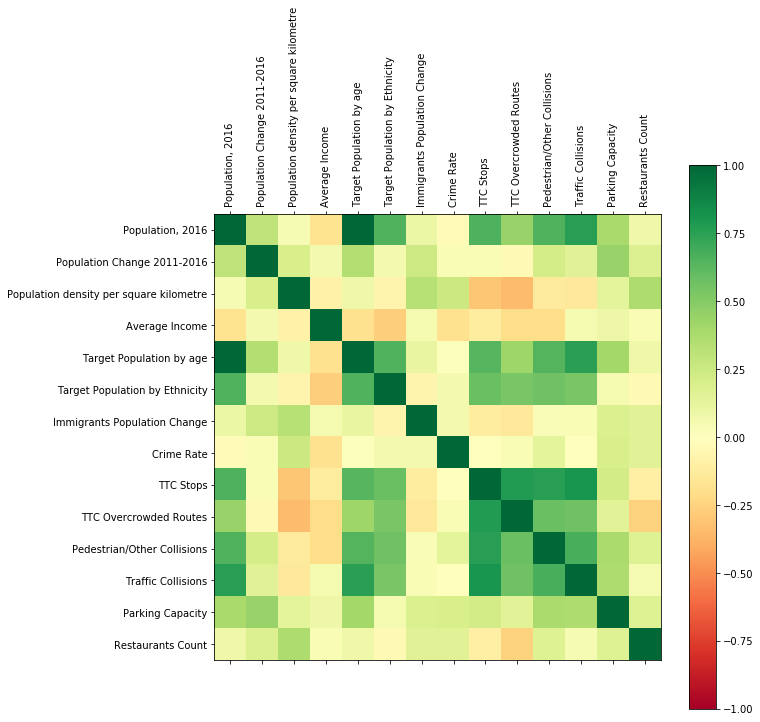

In [77]:
correlations = df_variables.corr()
# plot correlation matrix
fig = plt.figure(figsize=(10, 10))
plt.set_cmap('RdYlGn')
ax = fig.add_subplot(111)
cax = ax.matshow(correlations, vmin=-1, vmax=1)
fig.colorbar(cax)
ticks = np.arange(0,14,1)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(names,rotation=90)
ax.set_yticklabels(names)

plt.savefig('screenshots/correlation.png')

plt.show()

There does not seem to be a single clear determinant for the restaurants count in a neigbourhood. Therefore, we believe that the combination of them will provide an idea of the best location of a new restaurant. Hence, clustering the data and then analyzing is a good option.

### Clustering the data

Before we move to clustering, let's first normalize the data set to minimize the effect of the magnitudes of individual variables.

In [78]:
df_norm_variables = StandardScaler().fit_transform(df_variables)

In [88]:
df_clusters=df_data

Let's run kmeans to cluster the data in 5 groups

In [89]:
# set number of clusters
kclusters = 5

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(df_norm_variables)

#assign labels to each record
df_clusters['Cluster Labels'] = kmeans.labels_ + 1 # to start label number with 1

Now, let's see how the neighbourhoods are clustered

In [90]:
df_clusters['Cluster Labels'].value_counts()

3    63
4    35
2    30
5     7
1     5
Name: Cluster Labels, dtype: int64

The results show that most of the neighbourhoods are clustered in cluster number 5 while very less number are clusterd in 1 and 4. The cluster number 3 and 4 have 30 nieghbourhoods each.

OK, now visualize how the members of each cluster are distributed geographically.

#### Clusters Visualization

Let's visualize the clusters using choropleth. We actually plot the cluster labels  with discrete threshold scale so each neighbourhood is plotted in a color according to its label

In [91]:
# let Folium determine the scale.
cluster_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
cluster_map.choropleth(
    geo_data=toronto_geo,
    data=df_clusters,
    columns=['N_ID', 'Cluster Labels'],
    key_on='feature.properties.AREA_S_CD',
    threshold_scale=[1, 2, 3, 4, 5, 6],
    fill_color='Accent', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Clusters of nieghbourhoods',
    reset=True
)

cluster_map.save('screenshots/cluster.html')

cluster_map

Next, we will analyze the clusters for segmenting the neighbourhoods

### Clusters Analysis

The next step is to analyze the neighbourhoods in each cluster. We can easily check the centroid values by averaging the features in each cluster. So, let's do it

In [92]:
df_clusters.groupby('Cluster Labels').mean()

,"Population, 2016",Population Change 2011-2016,Population density per square kilometre,Average Income,Target Population by age,Target Population by Ethnicity,Immigrants Population Change,Crime Rate,TTC Stops,TTC Overcrowded Routes,Pedestrian/Other Collisions,Traffic Collisions,Parking Capacity,Restaurants Count
Cluster Labels,,,,,,,,,,,,,,
1,36951.200000,0.296000,13420.600000,55139.800000,33459.000000,2919.000000,0.296232,2677.518086,85.000000,96.800000,502.200000,350.200000,1917.000000,5.200000
2,16342.266667,0.055667,10125.833333,46862.733333,13855.000000,1033.500000,0.331221,1842.969666,42.200000,78.733333,137.133333,138.300000,192.133333,3.100000
3,13299.698413,0.020635,5006.603175,47072.333333,11164.603175,876.984127,0.003139,1241.638843,44.492063,139.111111,105.174603,119.984127,172.269841,0.698413
4,26713.400000,0.031429,4898.857143,34478.800000,22194.571429,2593.000000,0.065681,1113.717071,93.857143,237.400000,343.685714,238.314286,160.485714,1.600000
5,40528.142857,0.017143,2686.428571,30660.428571,34528.571429,8125.000000,0.012576,1502.859573,206.857143,957.857143,659.142857,484.857143,607.285714,0.285714


Analyzing the above results makes it evident that the cluster 4 makes the group of the most suitable neighbourhoods for opening a new Indian/Pakistani restaurant. Now, let's have a look at the cluster 4.

The analysis of the above results indicate that the neighbourhood number 122 **Waterfront Communities-The Island** is the most suitable candidate for hosting the new restaurant. However, for further convergence, let's re-cluster the cluster 4.

In [94]:
df_best_cluster=df_clusters.loc[df_clusters['Cluster Labels']==4]


In [95]:
df_norm_cluster = StandardScaler().fit_transform(df_best_cluster.drop(['Neighbourhood','N_ID','Cluster Labels'], axis=1, inplace=False))

In [96]:
# set number of clusters
kclusters = 3

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(df_norm_cluster)

#assign labels to each record
df_best_cluster['Re-Cluster Labels'] = kmeans.labels_ + 1 # to start label number with 1

/home/jupyterlab/conda/lib/python3.6/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [97]:
df_best_cluster['Re-Cluster Labels'].value_counts()

2    17
1    10
3     8
Name: Re-Cluster Labels, dtype: int64

Now, let's visualize them

In [100]:
# let Folium determine the scale.
recluster_map = folium.Map(location=[43.703798123073504, -79.36607231841656], zoom_start=11) # center manually set for the Toronto city
recluster_map.choropleth(
    geo_data=toronto_geo,
    data=df_best_cluster,
    columns=['N_ID', 'Re-Cluster Labels'],
    key_on='feature.properties.AREA_S_CD',
    threshold_scale=[1, 2, 3, 4],
    fill_color='Greens', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Clusters of nieghbourhoods',
    reset=True
)

recluster_map.save('screenshots/recluster.html')

recluster_map

In [99]:
df_best_cluster.groupby('Re-Cluster Labels').mean()

,"Population, 2016",Population Change 2011-2016,Population density per square kilometre,Average Income,Target Population by age,Target Population by Ethnicity,Immigrants Population Change,Crime Rate,TTC Stops,TTC Overcrowded Routes,Pedestrian/Other Collisions,Traffic Collisions,Parking Capacity,Restaurants Count,Cluster Labels
Re-Cluster Labels,,,,,,,,,,,,,,,
1,30673.100000,0.080000,5365.100000,44387.500000,26250.500000,1695.500000,0.168333,1146.326092,99.100000,215.500000,278.200000,316.500000,483.600000,0.900000,4
2,23948.176471,0.008824,5208.235294,31456.823529,19674.117647,2972.058824,0.063956,1100.224382,78.117647,240.470588,254.058824,180.176471,27.058824,1.117647,4
3,27639.875000,0.018750,3658.625000,28514.625000,22480.625000,2909.375000,-0.058969,1101.627759,120.750000,258.250000,616.000000,264.125000,40.125000,3.500000,4


The re-clustering also confirms our hypothesis that neighbourhood ***122 - Waterfront Communities-The Island*** is the most suitable candidate for hosting new Indian restaurant.

## Summary

In this project, we worked for identifying the best neighbourhood for a new Indian/Pakistani restaurant. The highlights of the work are as follows:
1. We collected data from various sources, such as Foursquare API, Toronto City's Open Data Catalogue, Toronto Police Open Data Catalogue, etc. 
2. The collected data was available in various formats including CSV, shapefile, JSON and xls.
3. The data preparation required lot of wrangling and cleaning before being available for the analysis.
4. For better understanidng, we visualized the distribution of variables of the dataset using choropleth maps
5. Correlation analysis was performed to investigate the determinants of restaurant count
6. Data was normalized before modeling the data
7. Cluster analysis was done to segment the neighbourhoods for the suitability of hosting a new Indian/Pakistni Restaurant.
8. The best neighbourhood was determined.

***Thanks for the review***